# ResMaskDepthGenerator
---

## Installing Packages
---

In [0]:
!pip install kornia
!pip install GPUtil
!pip install torchviz

     |████████████████████████████████| 163kB 3.5MB/s 
  Created wheel for GPUtil: filename=GPUtil-1.4.0-cp36-none-any.whl size=7413 sha256=b251a05f317276d3c0819bd7f6a0e55f11a40e6b4eb86946d4ee88061887006e
  Stored in directory: /root/.cache/pip/wheels/3d/77/07/80562de4bb0786e5ea186911a2c831fdd0018bda69beab71fd
Successfully built GPUtil
     |████████████████████████████████| 51kB 2.4MB/s 
  Created wheel for torchviz: filename=torchviz-0.0.1-cp36-none-any.whl size=3523 sha256=a169757bfb120df09bac5b99c079499a1ca286ecd5041532644654217d0f0e3c
  Stored in directory: /root/.cache/pip/wheels/2a/c2/c5/b8b4d0f7992c735f6db5bfa3c5f354cf36502037ca2b585667
Successfully built torchviz


# Setting up Tensorboard and drive
---

In [0]:
%load_ext tensorboard

In [0]:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive


In [0]:
import os
os.chdir('gdrive/My Drive/EVA4/')

In [0]:
logs_base_dir = "./runs"
os.makedirs(logs_base_dir, exist_ok=True)
default_path = "./MaskDepthData/"

# Importing packages
---

In [0]:
from API import *

  pip install torch-lr-finder -v --global-option="amp"


# Dataset Creation
---

In [0]:
batch_size = 64
bg_dir_path = default_path + 'bg'
depth_zip_file_name = default_path + 'DepthData.zip'
mask_zip_file_name = default_path + 'mask_data.zip'
dir_checkpoint_path = './training/'

num_workers = 8

In [0]:
train_loader, test_loader = data_engine.data_utility.getTrainingTestingData(dataset_name='maskDepthDatasetMemory', dataset_params={'resize': (160,160), 'default_resize': (160,160)}, batch_size=batch_size, bg_dir_path=bg_dir_path, depth_zip_file_name=depth_zip_file_name, mask_zip_file_name=mask_zip_file_name, is_depth=True, is_mask=True, i=0, subset=False, subset_size=10000, val_percent=0.3, num_workers=num_workers)

Loading dataset zip file...Loaded (400000).


# Model Creation
---

In [0]:
from torchsummary import summary

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

original_model = models.seg_resnet.resnet18(pretrained = True).to(device)
model = models.ResDepthMaskGenerator(original_model, 512, 1).to(device)

Downloading: "https://download.pytorch.org/models/resnet18-5c106cde.pth" to /root/.cache/torch/checkpoints/resnet18-5c106cde.pth


In [0]:
summary(model, (6, 160, 160))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 160, 160]           3,456
       BatchNorm2d-2         [-1, 64, 160, 160]             128
              ReLU-3         [-1, 64, 160, 160]               0
         MaxPool2d-4           [-1, 64, 80, 80]               0
            Conv2d-5           [-1, 64, 80, 80]          36,864
       BatchNorm2d-6           [-1, 64, 80, 80]             128
              ReLU-7           [-1, 64, 80, 80]               0
            Conv2d-8           [-1, 64, 80, 80]          36,864
       BatchNorm2d-9           [-1, 64, 80, 80]             128
             ReLU-10           [-1, 64, 80, 80]               0
       BasicBlock-11           [-1, 64, 80, 80]               0
           Conv2d-12           [-1, 64, 80, 80]          36,864
      BatchNorm2d-13           [-1, 64, 80, 80]             128
             ReLU-14           [-1, 64,

In [0]:
import kornia
criterion_depth = torch.nn.L1Loss() 
criterion_mask = torch.nn.BCEWithLogitsLoss()

optimizer = torch.optim.SGD(model.parameters(), lr = 0.01, momentum=0.99, weight_decay=1e-5)

In [0]:
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter(comment='{}-lr{}-e{}-{}'.format('ResDepthMaskGenerator', 0.01, 10, 64))

## Writing model graph to tensorboard
---

In [0]:
samples = next(iter(train_loader))
with torch.no_grad():
  samples['bg'] = samples['bg'].to(device)
  samples['image'] = samples['image'].to(device)
  samples['depth'] = samples['depth'].to(device)
  samples['mask'] = samples['mask'].to(device)
writer.add_graph(model, samples)
writer.close

<bound method SummaryWriter.close of <torch.utils.tensorboard.writer.SummaryWriter object at 0x7fb4a724ccc0>>

# Model Training
---

In [0]:
train_losses, test_losses = train_test_predict.segmentation.train_epoch(model_name='ResDepthMaskGenerator', model=model, criterion_depth=criterion_depth, criterion_mask=criterion_mask, optimizer=optimizer, scheduler=None, train_loader=train_loader, test_loader=test_loader, epochs=5, batch_size=batch_size, lr=0.01, save_cp=True, dir_checkpoint=dir_checkpoint_path, is_accumulate=False, is_val=True, init_epoch=1, img_step=2)

ResDepthMaskGenerator-lr0.01-e5-128


GPU Usage after loading sample batches in epoch 1 and iteration 0: 
| ID | GPU | MEM |
------------------
|  0 |  1% |  6% |
Actual Prediction time: 0.18389391899108887 sec
GPU Usage after forward pass in epoch 1 and iteration 0: 
| ID | GPU | MEM |
------------------
|  0 | 55% | 24% |
Actual Backprop time: 0.0453639030456543 sec
GPU Usage after backward pass in epoch 1 and iteration 0: 
| ID | GPU | MEM |
------------------
|  0 | 20% | 27% |
Epoch: [1][0/3125]	Time 17.471 (17.471)	ETA 15:09:56	Loss 0.1645 (0.1645)
GPU Usage after 1 sample training in epoch 1 and iteration 0: 
| ID | GPU | MEM |
------------------
|  0 |  0% | 27% |
Train Logging time: 1.5024967193603516 sec



Total val logging and validation time: 82.1636893749237 sec
Epoch Loss: 0.12311542098760604


GPU Usage after loading sample batches in epoch 2 and iteration 0: 
| ID | GPU | MEM |
------------------
|  0 |  1% | 44% |
Actual Prediction time: 0.02313852310180664 sec
GPU Usage after forward pass in epoch 2 and iteration 0: 
| ID | GPU | MEM |
------------------
|  0 |  0% | 44% |
Actual Backprop time: 0.14580345153808594 sec
GPU Usage after backward pass in epoch 2 and iteration 0: 
| ID | GPU | MEM |
------------------
|  0 | 60% | 44% |
Epoch: [2][0/3125]	Time 3.782 (3.782)	ETA 3:16:57	Loss 0.1226 (0.1226)
GPU Usage after 1 sample training in epoch 2 and iteration 0: 
| ID | GPU | MEM |
------------------
|  0 |  0% | 44% |
Train Logging time: 1.9663496017456055 sec



Total val logging and validation time: 83.20760655403137 sec
Epoch Loss: 0.10323027234315872


Epoch: [3][0/3125]	Time 2.958 (2.958)	ETA 2:34:02	Loss 0.0984 (0.0984)



Total val logging and validation time: 80.87618231773376 sec
Epoch Loss: 0.09193185419082642


Epoch: [4][0/3125]	Time 3.068 (3.068)	ETA 2:39:48	Loss 0.0906 (0.0906)



Total val logging and validation time: 83.52901101112366 sec
Epoch Loss: 0.08659296991586685


Epoch: [5][0/3125]	Time 2.940 (2.940)	ETA 2:33:08	Loss 0.0993 (0.0993)



Total val logging and validation time: 81.69493174552917 sec
Epoch Loss: 0.08099280581712723



In [0]:
train_losses, test_losses = train_test_predict.segmentation.train_epoch(model_name='ResDepthMaskGenerator', model=model, criterion_depth=criterion_depth, criterion_mask=criterion_mask, optimizer=optimizer, scheduler=None, train_loader=train_loader, test_loader=test_loader, epochs=1, batch_size=batch_size, lr=0.01, save_cp=True, dir_checkpoint=dir_checkpoint_path, is_accumulate=False, is_val=True, init_epoch=6, img_step=1)

ResDepthMaskGenerator-lr0.01-e1-64


GPU Usage after loading sample batches in epoch 6 and iteration 0: 
| ID | GPU | MEM |
------------------
|  0 |  0% | 44% |
Actual Prediction time: 0.06960439682006836 sec
GPU Usage after forward pass in epoch 6 and iteration 0: 
| ID | GPU | MEM |
------------------
|  0 |  0% | 54% |
Actual Backprop time: 0.26958775520324707 sec
GPU Usage after backward pass in epoch 6 and iteration 0: 
| ID | GPU | MEM |
------------------
|  0 | 79% | 56% |
Epoch: [6][0/6250]	Time 11.494 (11.494)	ETA 19:57:14	Loss 1.1145 (1.1145)
GPU Usage after 1 sample training in epoch 6 and iteration 0: 
| ID | GPU | MEM |
------------------
|  0 |  0% | 56% |
Train Logging time: 2.7381131649017334 sec


In [0]:
train_loss, test_loss = train_epoch(writer, model_name='ResDepthMaskGenerator', model=model, criterion_depth=criterion_depth, criterion_mask=criterion_mask, optimizer=optimizer, scheduler=None, train_loader=train_loader, test_loader=test_loader, epochs=5, batch_size=batch_size, lr=0.01, save_cp=True, dir_checkpoint=dir_checkpoint_path, is_accumulate=False, is_val=True, init_epoch=7, img_step=2)

ResDepthMaskGenerator-lr0.01-e5-64


Actual Prediction time: 0.14513325691223145 sec
Actual Backprop time: 0.26882100105285645 sec
Epoch: [7][0/4375]	Time 2.949 (2.949)	ETA 3:35:01	Loss 0.2371 (0.2371)
Train Logging time: 2.2492010593414307 sec

Epoch Loss: 0.21253775101900102


# Visualization
---

In [0]:
%tensorboard --logdir ./runs

<IPython.core.display.Javascript object>

# Predictions
---

In [0]:
sample_batched, output_depth, output_mask = train_test_predict.segmentation.predict(model, test_loader)

## Prediction after training with 80x80 image size for 5 Epochs
---
**1) Background Input Image**

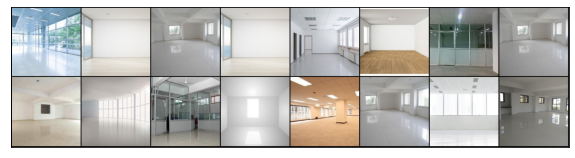

In [0]:
viz_utility.show(sample_batched['bg'][:16])

**2) Foreground overlayed on Background Input Image**

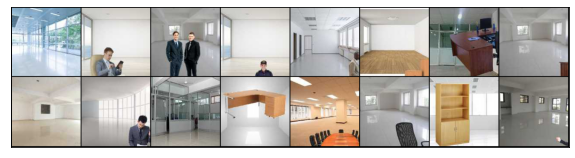

In [0]:
viz_utility.show(sample_batched['image'][:16])

**3) Predicted Depth Output Image**

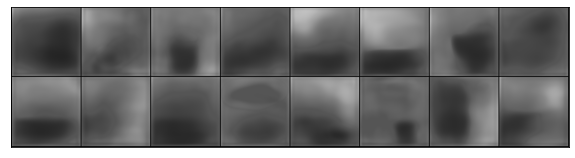

In [0]:
viz_utility.show(output_depth[:16])

**4) True Depth Image**

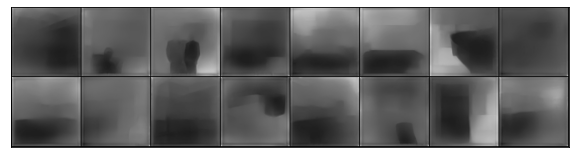

In [0]:
viz_utility.show(sample_batched['depth'][:16])

**5) Predicted Mask Output Image**

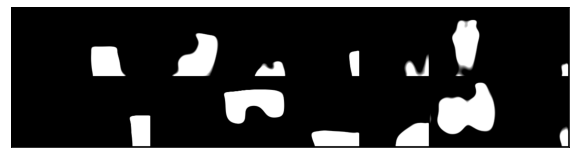

In [0]:
viz_utility.show(output_mask[:16])

**6) True Mask Image**

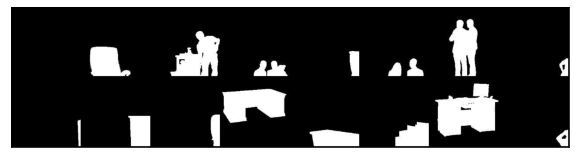

In [0]:
viz_utility.show(sample_batched['mask'][:16])

## Prediction after training with 160x160 image size for 1 Epoch
---

**1) Background Input Image**

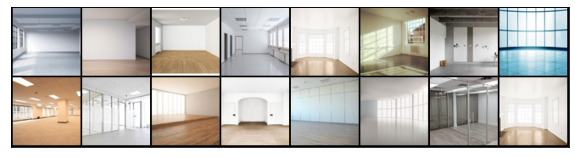

In [0]:
viz_utility.show(sample_batched['bg'][:16])

**2) Foreground overlayed on Background Input Image**

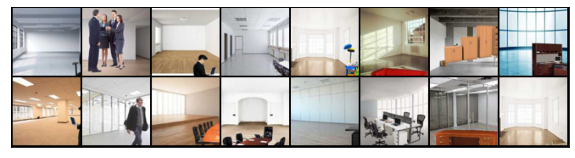

In [0]:
viz_utility.show(sample_batched['image'][:16])

**3) Predicted Depth Output Image**

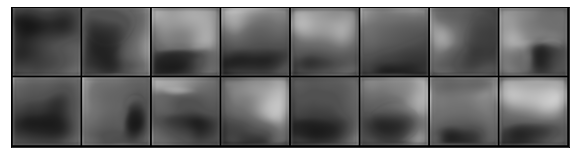

In [0]:
viz_utility.show(output_depth[:16])

**4) True Depth Image**

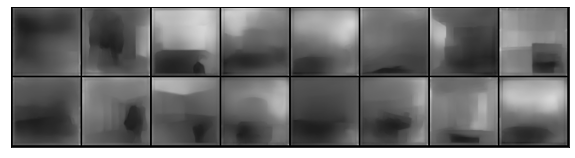

In [0]:
viz_utility.show(sample_batched['depth'][:16])

**5) Predicted Mask Output Image**

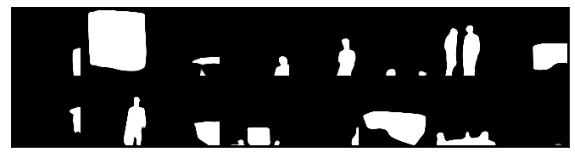

In [0]:
viz_utility.show(output_mask[:16])

**6) True Mask Image**

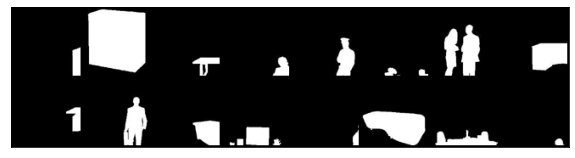

In [0]:
viz_utility.show(sample_batched['mask'][:16])